# BOnScope DB Viewer & Analysis
### Visualization for Linux W/S DB

In [1]:
# 라이브러리 불러오기

import os
import sys
import pymysql
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.io as pio
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import time
from scipy.optimize import curve_fit
from sklearn.metrics import r2_score
import plotlyuser as pu
import kuserlib as k
import sqldblib as sq

# 서비스 서버 (리눅스, DB 2가지 : gsmbiz, gsmbiz_result)
conn = pymysql.connect(host='192.168.30.41', user='gsmbiz_master', password='mysql1234!', port=3306, db='gsmbiz_result', local_infile=False)
conn_db = pymysql.connect(host='192.168.30.41', user='gsmbiz_master', password='mysql1234!', port=3306, db='gsmbiz', local_infile=False)


columns_name = ['deviceNo', 'messageTime', 'time', 'startTime', 'internalTemp',
       'externalTemp', 'soc', 'acceptableChargingPower',
       'acceptableDischargingPower', 'mainRelayConnected',
       'slowChargingPortConnected', 'fastChargingPortConnected', 'v2l',
       'packCurrent', 'packVoltage', 'moduleMaxTemp', 'moduleMinTemp',
       'moduleTempList', 'battInternalTemp', 'maxCellVoltage',
       'maxCellVoltageNo', 'minCellVoltage', 'minCellVoltageNo',
       'battFanRunning', 'subBattVoltage', 'cumulativeCurrentCharged',
       'cumulativeCurrentDischarged', 'cumulativePowerCharged',
       'cumulativePowerDischarged', 'operationTime', 'bmsRunning',
       'inverterCapacityVoltage', 'driveMotorSpd1', 'driveMotorSpd2',
       'insulatedResistance', 'cellVoltageList', 'cellVoltageDispersion',
       'airbagHWireDuty', 'hvacList1', 'hvacList2', 'soh',
       'maxDeteriorationCellNo', 'minDeterioratation',
       'minDeteriorationCellNo', 'socd', 'emobilitySpeed', 'moduleAvgTemp',
       'batteryPower', 'odometer', 'fastChargingRelayOn',
       'chargingCableConnected', 'estimatedChargingTime', 'tripChargingPower',
       'tripDischargingPower', 'battCoolantInletTemp', 'battPraBusbarTemp',
       'battLtrRearTemp', 'chargeCount', 'chargeCountQuick', 'umulEnergyChrgd',
       'cumulEnergyChrgdQuick']


# 부동소수점 표현 변경
pd.options.display.float_format = '{:.4f}'.format


In [2]:
# DB 용량 확인하기

db_name = 'gsmbiz_result'

sq.check_dbsize(conn, db_name)

,DB name,size_MB
0,mysql,4.2
1,information_schema,0.0
2,performance_schema,0.0
3,sys,0.0
4,gsmbiz_result,170.2
5,gsmbiz,3236737.3
6,data_backup,10119.2
7,gsmbiz_temp,2065189.8


In [3]:
# 전체 DB Table 리스트 확인하기

sq.view_tablelist(conn)

,table_name
0,car_info
1,car_spec
2,exe_log
3,offset
4,summary
5,time_log
6,v2_cal_soh
7,v2_cell_balance
8,v2_drive_record
9,v2_exe_log


In [4]:
table_name = 'v3_cal_soh'

cal_soh = sq.read_table_all(conn, table_name)
cal_soh

Table name :  v3_cal_soh


,upload_date,car_id,car_model,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction,fitting
0,2024-12-17 09:59:51,01229994779,아이오닉5,2022-09-29 12:59:14,2022-09-29 15:44:05,164.8000,0.5800,46.8609,68.5000,87.0000,18.5000,14058,3402.1000,100.0000,21.2000,103.0530,1.0000
1,2024-12-17 09:59:51,01229994779,아이오닉5,2022-10-02 17:37:44,2022-10-02 19:57:58,140.2000,0.5900,47.8512,37.0000,55.0000,18.0000,14373,3474.0000,100.0000,20.6000,102.9180,1.0000
2,2024-12-17 09:59:51,01229994779,아이오닉5,2022-10-04 07:05:13,2022-10-04 14:16:15,431.0000,0.6000,48.1432,37.0000,87.0000,50.0000,14462,3495.2000,100.0000,57.2000,102.8780,1.0000
3,2024-12-17 09:59:51,01229994779,아이오닉5,2022-10-07 07:05:12,2022-10-07 13:37:28,392.3000,0.6000,48.9063,40.5000,87.0000,46.5000,14699,3550.6000,100.0000,53.2000,102.8850,1.0000
4,2024-12-17 10:00:38,01241124004,EV6,2022-10-09 17:16:17,2022-10-09 20:05:40,169.4000,0.4800,12.1253,77.0000,96.5000,19.5000,4039,938.5000,100.0000,22.3000,102.8410,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134953,2025-07-03 00:22:59,01241597809,EV6,2025-07-01 23:24:54,2025-07-02 06:25:16,420.4000,3.7500,156.2730,37.5000,89.0000,51.5000,110175,12095.5000,100.0000,58.9000,102.8500,1.0000
134954,2025-07-03 00:23:47,01241597753,EV6,2025-07-01 22:36:18,2025-07-02 07:51:46,555.5000,3.2600,56.7287,36.5000,85.0000,48.5000,132851,4390.8000,100.0000,55.5000,102.9070,1.0000
134955,2025-07-03 00:23:47,01241597856,아이오닉5,2025-07-02 16:25:43,2025-07-02 16:37:55,12.2000,2.5900,68.5882,28.5000,73.5000,45.0000,16244,4979.5000,100.0000,51.5000,102.9180,1.0000
134956,2025-07-03 00:23:47,01241597856,아이오닉5,2025-07-02 17:20:01,2025-07-02 17:36:05,16.1000,2.5900,68.7287,69.0000,91.5000,22.5000,16303,4989.7000,100.0000,25.7000,102.7180,1.0000


In [5]:
cal_soh.columns

Index(['upload_date', 'car_id', 'car_model', 'start_time', 'end_time',
       'charge_minutes', 'model_year', 'end_cycle', 'start_soc', 'end_soc',
       'delta_soc', 'end_odometer', 'end_cumPowDischared', 'end_soh',
       'delta_Q', 'SOH_prediction', 'fitting'],
      dtype='object')

In [6]:
table_name = 'car_info'

car_info = sq.read_table_all(conn, table_name)
car_info

Table name :  car_info


,car_num,reg_date,car_model,release,cell_cnt,batteryReplace,qstd
0,01229662196,2022-10-07 02:59:47,GV60,20220623,192,,111.0000
1,01229663082,2022-09-23 07:32:12,GV60,20220301,192,,111.0000
2,01229663432,2022-10-07 02:57:24,GV60,20220615,192,,111.0000
3,01229664528,2022-10-07 02:57:48,GV60,20220615,192,,111.0000
4,01229994779,2022-09-16 01:19:57,아이오닉5,20220301,180,2022-12,111.0000
...,...,...,...,...,...,...,...
527,01241284722,2025-03-10 18:30:00,코나EV,20240301,98,,180.0000
528,old_01241248805,2023-01-05 10:30:02,아이오닉일렉트릭(AE),20190601,96,,78.0000
529,old_01241124056,2022-09-23 03:15:53,코나EV,20190228,98,,180.0000
530,01294957076,2025-04-18 19:30:00,아이오닉5,20250101,180,,111.0000


In [7]:
table_name = 'v3_summary'

df_summary = sq.read_table_all(conn, table_name)
df_summary

Table name :  v3_summary


,upload_date,car_model,car_id,start_time,end_time,time_range,cum_powercharged,cum_powerdischarged,start_odometer,end_odometer,...,min_battCooling_t,avg_battCooling_t,max_battbusbar_t,min_battbusbar_t,avg_battbusbar_t,max_battLtr_t,min_battLtr_t,avg_battLtr_t,sob,charge_score
0,2024/12/06 19:56:45,EV6,01241248892,2023-01-16 11:16:47,2024-12-05 20:30:59,689,157.9000,169.3000,34226,86377,...,-13,18.0000,58,-8,30.6000,54,-18,22.2000,NaN,NaN
1,2024/12/06 19:56:45,포터2,01241228177,2022-12-22 15:05:20,2024-12-05 19:53:05,714,15730.5000,15383.1000,16012,53557,...,-12,19.5000,56,-12,23.9000,50,-14,26.9000,NaN,NaN
2,2024/12/06 19:56:45,EV6,01241228110,2023-12-03 09:35:33,2024-12-05 23:59:59,368,697.3000,690.2000,17154,57466,...,-7,18.9000,52,-2,33.2000,53,-10,23.2000,NaN,NaN
3,2024/12/06 19:56:45,봉고3,01241228162,2022-12-24 14:30:28,2024-12-05 20:18:03,712,3904.8000,3667.8000,4911,15399,...,-8,11.4000,56,-6,22.7000,49,-9,12.2000,NaN,NaN
4,2024/12/06 19:56:45,봉고3,01241248647,2023-01-26 12:58:00,2024-12-02 17:42:30,676,1650.7000,1457.0000,346,4819,...,-4,17.3000,56,-2,24.4000,46,-4,19.2000,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9941,2025/07/03 15:49:51,EV6,01241228098,2023-01-20 18:21:25,2025-07-01 07:17:58,892,1178.2000,1147.0000,15613,58712,...,-7,18.7000,68,-2,30.5000,52,-11,21.5000,100.0000,99.5600
9942,2025/07/03 15:50:03,EV6,01241228059,2022-12-13 10:20:44,2025-07-02 21:01:23,932,4031.2000,3673.6000,1261,28787,...,-5,19.1000,50,-2,29.0000,54,-10,22.7000,100.0000,99.0300
9943,2025/07/03 15:50:04,포터2,01241248721,2023-05-01 06:45:19,2023-11-14 15:29:19,197,183.4000,174.5000,21067,27670,...,0,26.0000,58,0,29.4000,53,0,32.7000,100.0000,99.0500
9944,2025/07/03 15:50:20,포터2,01241248742,2023-05-01 06:33:19,2023-10-18 09:39:27,170,7924.2000,7348.1000,23027,25661,...,9,24.4000,38,10,27.3000,46,8,28.7000,NaN,94.7300


In [8]:
# 최근 데이터만 가져오기 (마지막 날짜 기준)

resent_time = cal_soh.loc[len(cal_soh)-1, 'upload_date'].date()

df_cal_soh = cal_soh[cal_soh['upload_date'].dt.date == resent_time].reset_index(drop=True)
df_cal_soh

,upload_date,car_id,car_model,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction,fitting
0,2025-07-03 00:10:44,01241225217,EV6,2025-07-02 09:29:06,2025-07-02 23:06:17,817.2000,1.5900,19.0594,48.0000,92.5000,44.5000,28950,1475.2000,100.0000,50.9000,102.8620,1.0000
1,2025-07-03 00:10:48,01241228051,EV6,2025-07-02 07:18:16,2025-07-02 07:35:28,17.2000,2.5900,40.1279,64.5000,88.5000,24.0000,64441,3105.9000,94.9000,27.4000,102.6680,1.0000
2,2025-07-03 00:10:48,01241172643,EV6,2025-07-01 12:13:35,2025-07-01 21:58:00,584.4000,1.9200,40.5827,28.5000,96.5000,68.0000,34576,3141.1000,100.0000,77.8000,102.8880,1.0000
3,2025-07-03 00:10:56,01241228037,아이오닉5,2025-07-02 18:40:53,2025-07-02 20:58:21,137.5000,2.7600,103.3930,80.0000,96.5000,16.5000,57078,7506.3000,100.0000,18.8000,102.4630,1.0000
4,2025-07-03 00:10:57,01241228117,봉고3,2025-07-02 15:45:43,2025-07-02 22:45:49,420.1000,5.2600,101.8150,25.0000,91.0000,66.0000,51822,5986.7000,97.3000,125.5000,105.6400,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154,2025-07-03 00:22:59,01241597809,EV6,2025-07-01 23:24:54,2025-07-02 06:25:16,420.4000,3.7500,156.2730,37.5000,89.0000,51.5000,110175,12095.5000,100.0000,58.9000,102.8500,1.0000
155,2025-07-03 00:23:47,01241597753,EV6,2025-07-01 22:36:18,2025-07-02 07:51:46,555.5000,3.2600,56.7287,36.5000,85.0000,48.5000,132851,4390.8000,100.0000,55.5000,102.9070,1.0000
156,2025-07-03 00:23:47,01241597856,아이오닉5,2025-07-02 16:25:43,2025-07-02 16:37:55,12.2000,2.5900,68.5882,28.5000,73.5000,45.0000,16244,4979.5000,100.0000,51.5000,102.9180,1.0000
157,2025-07-03 00:23:47,01241597856,아이오닉5,2025-07-02 17:20:01,2025-07-02 17:36:05,16.1000,2.5900,68.7287,69.0000,91.5000,22.5000,16303,4989.7000,100.0000,25.7000,102.7180,1.0000


In [9]:
# 필터 조건 (누적데이터 기준)

data_soh = cal_soh[cal_soh['delta_soc'] > 50]
data_soh = data_soh[cal_soh['SOH_prediction'] < 120]
data_soh = data_soh[cal_soh['SOH_prediction'] > 70]
data_soh = data_soh[data_soh['start_soc'] != 0]
data_soh

C:\Users\minms\AppData\Local\Temp\ipykernel_8968\3910403880.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_soh = data_soh[cal_soh['SOH_prediction'] < 120]
C:\Users\minms\AppData\Local\Temp\ipykernel_8968\3910403880.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_soh = data_soh[cal_soh['SOH_prediction'] > 70]


,upload_date,car_id,car_model,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction,fitting
6,2024-12-17 09:59:51,01229994779,아이오닉5,2022-10-10 08:42:09,2022-10-10 09:18:39,36.5000,0.6100,49.9642,30.0000,85.0000,55.0000,14993,3627.4000,100.0000,62.9000,102.8450,1.0000
7,2024-12-17 10:01:02,old_01241124056,코나EV,2022-10-13 09:42:28,2022-10-13 15:36:25,353.9000,3.6300,14.8109,21.0000,75.0000,54.0000,70218,947.9000,100.0000,101.2000,104.1150,1.0000
17,2024-12-17 09:59:51,01229994779,아이오닉5,2022-10-25 08:57:49,2022-10-25 17:50:44,532.9000,0.6500,55.1006,35.0000,96.5000,61.5000,16568,4000.3000,100.0000,70.4000,102.9420,1.0000
27,2024-12-17 09:59:51,01229994779,아이오닉5,2022-11-03 08:18:15,2022-11-03 16:21:55,483.7000,0.6800,58.4422,30.5000,87.0000,56.5000,17577,4242.9000,100.0000,64.6000,102.8200,1.0000
31,2024-12-17 10:01:02,old_01241124056,코나EV,2022-11-09 08:52:59,2022-11-09 17:16:01,503.0000,3.7000,119.7770,25.0000,96.0000,71.0000,71007,7665.7000,100.0000,133.1000,104.1470,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134926,2025-07-03 00:20:49,01241364703,포터2,2025-07-02 15:39:32,2025-07-02 19:44:11,244.7000,5.4200,162.2480,16.5000,72.0000,55.5000,28214,9540.2000,100.0000,105.5000,105.6060,1.0000
134931,2025-07-03 00:20:56,01241597728,EV6,2025-07-01 17:46:44,2025-07-02 00:58:26,431.7000,3.8400,7.3398,43.5000,96.0000,52.5000,70126,568.1000,99.8000,60.1000,102.9460,1.0000
134934,2025-07-03 00:21:06,01241364659,봉고3,2025-07-01 18:45:27,2025-07-02 01:46:59,421.5000,4.3400,169.2820,31.0000,96.0000,65.0000,82699,9953.8000,100.0000,123.6000,105.6410,1.0000
134940,2025-07-03 00:22:06,01241597816,아이오닉5,2025-07-01 23:46:53,2025-07-02 00:05:12,18.3000,3.4200,185.5830,35.0000,88.0000,53.0000,80425,13473.3000,100.0000,60.6000,102.8230,1.0000


In [10]:
input_df = data_soh
x_name = 'end_cycle'
y_name = 'SOH_prediction'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [11]:
# 특정 차량 선택

select_car_id = '01241123951'

select_soh = data_soh[data_soh['car_id'] == select_car_id]
select_soh

,upload_date,car_id,car_model,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction,fitting
10069,2024-12-17 10:00:26,01241123951,EV6,2023-05-02 15:30:33,2023-05-02 16:14:46,44.2000,0.9200,26.9819,25.0000,79.5000,54.5000,8799,2088.4000,100.0000,62.3000,102.7980,1.0000
10477,2024-12-17 10:00:26,01241123951,EV6,2023-05-05 12:59:40,2023-05-05 13:53:15,53.6000,0.9300,29.0814,43.0000,95.0000,52.0000,9432,2250.9000,100.0000,59.5000,102.8980,1.0000
11162,2024-12-17 10:00:26,01241123951,EV6,2023-05-11 13:00:59,2023-05-11 13:29:13,28.2000,0.9400,33.3140,28.0000,86.5000,58.5000,10769,2578.5000,100.0000,67.0000,102.9950,1.0000
11193,2024-12-17 10:00:26,01241123951,EV6,2023-05-11 18:17:29,2023-05-11 19:16:00,58.5000,0.9400,33.9716,43.0000,95.0000,52.0000,11002,2629.4000,100.0000,59.5000,102.8980,1.0000
11306,2024-12-17 10:00:26,01241123951,EV6,2023-05-12 13:30:49,2023-05-12 21:33:03,482.2000,0.9500,34.7985,38.5000,96.0000,57.5000,11323,2693.4000,100.0000,65.8000,102.9090,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107396,2025-01-10 04:00:24,01241123951,EV6,2025-01-08 19:04:29,2025-01-09 04:32:34,568.1000,2.6100,93.0452,20.5000,96.0000,75.5000,48140,7201.7000,100.0000,86.3000,102.7920,1.0000
107769,2025-01-11 04:00:25,01241123951,EV6,2025-01-10 10:33:25,2025-01-10 11:25:02,51.6000,2.6200,94.0388,19.0000,86.0000,67.0000,48441,7278.6000,100.0000,76.7000,102.9470,1.0000
108132,2025-01-13 04:00:23,01241123951,EV6,2025-01-11 21:30:55,2025-01-12 05:10:58,460.1000,2.6200,95.3734,26.5000,87.0000,60.5000,48896,7381.9000,100.0000,69.2000,102.8600,1.0000
110061,2025-01-22 04:00:20,01241123951,EV6,2025-01-21 14:06:05,2025-01-21 14:35:28,29.4000,2.6500,96.1499,31.5000,85.0000,53.5000,49170,7442.0000,100.0000,61.2000,102.8710,1.0000


In [12]:
input_df = select_soh
x_name = 'end_cycle'
y_name = 'SOH_prediction'
z_name = 'car_id'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

Fitted equation: y = 0.000 * x + 102.860


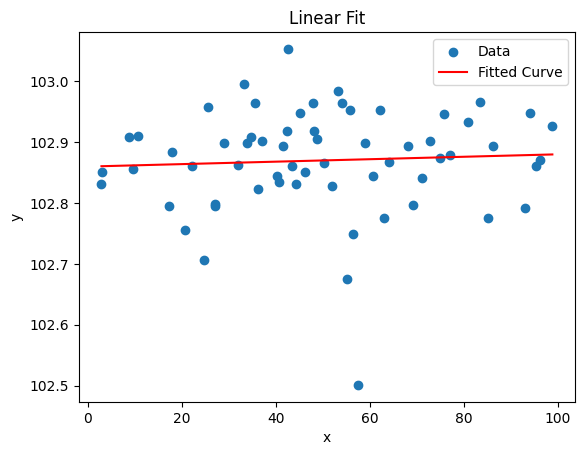

In [13]:
from scipy.optimize import curve_fit

# 1. 예시 데이터
x_data = select_soh['end_cycle']
y_data = select_soh['SOH_prediction']

# 2. 지수 함수 정의: y = ax+b
def linear_func(x, a, b):
    return a * x + b

# 3. curve_fit을 통해 파라미터 피팅
popt, pcov = curve_fit(linear_func, x_data, y_data)

a_fit, b_fit = popt
print(f"Fitted equation: y = {a_fit:.3f} * x + {b_fit:.3f}")

# 4. 결과 시각화
x_fit = np.linspace(min(x_data), max(x_data), 100)
y_fit = linear_func(x_fit, *popt)

plt.scatter(x_data, y_data, label="Data")
plt.plot(x_fit, y_fit, 'r-', label="Fitted Curve")
plt.legend()
plt.xlabel("x")
plt.ylabel("y")
plt.title("Linear Fit")
plt.show()

## LifeCycle view

In [11]:
sq.view_tablelist(conn)

,table_name
0,car_info
1,car_spec
2,exe_log
3,offset
4,summary
5,time_log
6,v2_cal_soh
7,v2_cell_balance
8,v2_drive_record
9,v2_exe_log


In [12]:
table_name = 'v3_cal_soh'

v3_cal_soh = sq.read_table_all(conn, table_name)
max_cal_soh = v3_cal_soh.groupby('car_id').agg({'model_year':'max',
                                               'end_cycle':'max'})
max_cal_soh.reset_index(inplace=True)
# max_cal_soh

Table name :  v3_cal_soh


In [13]:
table_name = 'v3_fin_result'

v3_rst = sq.read_table_all(conn, table_name)
v3_rst = v3_rst[v3_rst['upload_date']==v3_rst['upload_date'].max()]
v3_rst.columns

Table name :  v3_fin_result


Index(['upload_date', 'car_id', 'car_model', 'model_year', 'charge_point',
       'certi_TF', 'fit_initial', 'fit_alpha', 'r2', 'remainig_year',
       'present_soh', 'after_y1_soh', 'after_y2_soh', 'after_y3_soh',
       'after_y4_soh', 'after_y5_soh', 'after_y6_soh', 'after_y7_soh',
       'after_y8_soh', 'after_y9_soh', 'after_y10_soh', 'model_y0_soh',
       'model_y1_soh', 'model_y2_soh', 'model_y3_soh', 'model_y4_soh',
       'model_y5_soh', 'model_y6_soh', 'model_y7_soh', 'model_y8_soh',
       'model_y9_soh', 'model_y10_soh', 'init_soh', 'init_km', 'present_km',
       'after_y1_km', 'after_y3_km', 'one_cycle_km', 'best_worst_coef',
       'reset_TF'],
      dtype='object')

In [14]:
# 시각화 하기 (Scatter Plot, 현재 SOH)

input_df = v3_rst[v3_rst['charge_point']>=10]
x_name = 'car_id'
y_name = 'present_soh'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [19]:
v3_rst[v3_rst['car_id'] == '01241124056']

,upload_date,car_id,car_model,model_year,charge_point,certi_TF,fit_initial,fit_alpha,r2,remainig_year,...,model_y9_soh,model_y10_soh,init_soh,init_km,present_km,after_y1_km,after_y3_km,one_cycle_km,best_worst_coef,reset_TF
113556,2025-07-03 00:24:22,01241124056,코나EV,1.5600,27,0.0000,105.7100,-0.0005,0.1230,531.4500,...,105.0100,104.9300,105.7100,463.8900,463.5400,463.2600,462.7800,438.8300,5.0000,None


In [15]:
# Worst Case 확인 (fit 기울기 기준)

df_10up = v3_rst[v3_rst['charge_point']>=10]
df_min_soh = pd.DataFrame(columns=df_10up.columns)

for i, n in enumerate(df_10up['car_model'].unique()):
    
    select_car = n

    select_df = df_10up[df_10up['car_model'] == select_car].sort_values(by='fit_alpha')
    select_df = select_df.reset_index(drop=True)
    
    df_min_soh.loc[i] = select_df.iloc[0]

df_min_soh = pd.merge(left = df_min_soh , right = max_cal_soh, how = "left", on = "car_id")
csv_worst_df = df_min_soh[['car_model','car_id','fit_initial','present_soh','fit_alpha','end_cycle','remainig_year']]
csv_worst_df

,car_model,car_id,fit_initial,present_soh,fit_alpha,end_cycle,remainig_year
0,아이오닉5,01241228035,102.3500,101.1100,-0.0031,72.4201,79.5900
1,봉고3,01241228161,104.8800,104.1500,-0.0020,164.3690,134.4500
2,EV6,01241364602,102.3900,100.4600,-0.0060,28.1382,41.1300
3,코나EV,01241592890,106.5500,105.1500,-0.0028,47.7328,100.8800
4,GV60,01241228143,102.3100,101.2000,-0.0034,92.3566,71.4000
5,포터2,01241248765,105.0700,103.7700,-0.0037,192.4150,73.2700
6,아이오닉5스탠다드,01241592895,102.1400,101.6900,-0.0015,179.8710,162.1400
7,니로EV(~2021년식),01241228155,104.7500,104.3100,-0.0019,206.0000,139.1900
8,아이오닉5(2023~),01241248782,101.9200,101.8400,-0.0003,413.3810,811.3000
9,EV6스탠다드,01241288132,102.0700,101.8000,-0.0017,86.2415,145.8000


In [16]:
# Best Case 확인

df_max_soh = pd.DataFrame(columns=df_10up.columns)

for i, n in enumerate(df_10up['car_model'].unique()):
    
    select_car = n

    select_df = df_10up[(df_10up['car_model'] == select_car)&(df_10up['fit_alpha'] < 0) ].sort_values(by='fit_alpha', ascending = False)
    select_df = select_df.reset_index(drop=True)
    
    df_max_soh.loc[i] = select_df.iloc[0]
    
df_max_soh = pd.merge(left = df_max_soh , right = max_cal_soh, how = "left", on = "car_id")
csv_best_df = df_max_soh[['car_model','car_id','fit_initial','present_soh','fit_alpha','end_cycle','remainig_year']]
csv_best_df

,car_model,car_id,fit_initial,present_soh,fit_alpha,end_cycle,remainig_year
0,아이오닉5,01241228025,101.8900,101.8800,-0.0001,249.2670,4832.1700
1,봉고3,01241364634,104.6700,104.6500,-0.0001,329.7310,3074.7100
2,EV6,01241228055,101.8500,101.8400,-0.0001,362.0480,3825.6700
3,코나EV,01241248726,105.8700,105.6000,-0.0004,247.0800,679.4100
4,GV60,01241228136,102.1600,101.9900,-0.0006,157.6930,413.9400
5,포터2,01241248699,105.6700,105.6400,-0.0001,753.1580,4924.7600
6,아이오닉5스탠다드,01241228018,101.9000,101.7600,-0.0005,221.3780,474.8700
7,니로EV(~2021년식),01241228153,104.9400,104.6100,-0.0005,319.0200,590.9000
8,아이오닉5(2023~),01241248782,101.9200,101.8400,-0.0003,413.3810,811.3000
9,EV6스탠다드,01241364649,101.9100,101.8300,-0.0004,135.5870,665.9700


In [26]:
pd.concat([df_max_soh[['car_id','car_model','fit_alpha','end_cycle','remainig_year','charge_point']],
           df_min_soh[['car_id','car_model','fit_alpha','end_cycle','remainig_year','charge_point']] ], axis=1)

,car_id,car_model,fit_alpha,end_cycle,remainig_year,charge_point,car_id,car_model,fit_alpha,end_cycle,remainig_year,charge_point
0,01241228025,아이오닉5,-0.0001,249.2670,4832.1700,165,01241228035,아이오닉5,-0.0031,72.4201,79.5900,13
1,01241248749,봉고3,-0.0000,282.3160,9231.1200,454,01241228161,봉고3,-0.0020,164.3690,134.4500,63
2,01241228055,EV6,-0.0001,362.0480,4253.4100,302,01241597735,EV6,-0.0224,15.8656,11.3900,11
3,01241248726,코나EV,-0.0004,247.0800,650.2200,131,01241592890,코나EV,-0.0028,43.1469,100.8800,12
4,01241228136,GV60,-0.0006,143.2080,391.6100,102,01241228143,GV60,-0.0034,92.3566,71.4000,17
5,01241248672,포터2,-0.0001,1471.0600,4633.7900,784,01241248765,포터2,-0.0037,192.4150,73.2700,45
6,01241228018,아이오닉5스탠다드,-0.0005,221.3780,474.8700,117,01241592895,아이오닉5스탠다드,-0.0015,179.8710,162.1400,63
7,01241228153,니로EV(~2021년식),-0.0005,301.2230,557.2200,131,01241228155,니로EV(~2021년식),-0.0019,206.0000,139.1900,24
8,01241248782,아이오닉5(2023~),-0.0003,394.0160,814.1700,124,01241248782,아이오닉5(2023~),-0.0003,394.0160,814.1700,124
9,01241364649,EV6스탠다드,-0.0005,135.5870,523.7200,144,01241288132,EV6스탠다드,-0.0011,86.2415,212.8000,56


In [28]:
# SOH가 감속하는 데이터만 선택

result_select = v3_rst[v3_rst['fit_alpha'] < 0]

In [30]:
result_select['fit_alpha'].describe()

count   490.0000
mean     -0.0014
std       0.0025
min      -0.0452
25%      -0.0016
50%      -0.0010
75%      -0.0006
max      -0.0000
Name: fit_alpha, dtype: float64

In [31]:
# SOH에 대한 Curve 그래프

dataset = result_select
car_model = 'EV6'   # 차종 선택

df_reset = dataset[dataset['car_model'] == car_model].reset_index()
col_1 = 'fit_initial'
col_2 = 'fit_alpha'

soh_trend_list = []
cycle_end = 2000    # 마지막 사이클

def func(t, a, b):
    return a * np.exp(b*t)

for n in range(len(df_reset)):

    t = np.arange(cycle_end)
    a = df_reset.loc[n, col_1]
    b = df_reset.loc[n, col_2]

    soh_out = func(t, a, b)
    soh_trend_list.append(soh_out)
    
soh_trend_list

[array([101.98      , 101.90951703, 101.83908277, ...,  25.63818566,
         25.62046596,  25.6027585 ]),
 array([102.17      , 102.03130037, 101.89278903, ...,   6.77875511,
          6.76955269,   6.76036277]),
 array([102.02      , 101.92424981, 101.82858949, ...,  15.64291071,
         15.62822916,  15.61356139]),
 array([101.95      , 101.90005378, 101.85013203, ...,  38.31703533,
         38.29826347,  38.27950081]),
 array([102.04      , 101.96057666, 101.88121515, ...,  21.55019504,
         21.53342134,  21.5166607 ]),
 array([102.11      , 102.00220121, 101.89451623, ...,  12.38739562,
         12.3743181 ,  12.36125438]),
 array([102.02      , 101.92017986, 101.82045738, ...,  14.4439208 ,
         14.42978834,  14.4156697 ]),
 array([101.9       , 101.69902747, 101.4984513 , ...,   1.97686951,
          1.97297063,   1.96907943]),
 array([102.03      , 101.94840783, 101.8668809 , ...,  20.64867002,
         20.63215753,  20.61565824]),
 array([102.04      , 101.95868807, 1

In [32]:
# 시각화 하기 (Line Plot)

fig = go.Figure()

t = np.arange(cycle_end)

for n in range(len(df_reset)):

    fig.add_trace(go.Scatter(x=t, y=soh_trend_list[n], mode='lines'))

fig.update_layout(title_text = 'SOH Prediction (B-OnScope) : ' + car_model)
fig.update_layout(template ='plotly_dark', width=1000, height=600)
fig.update_xaxes(title_text = 'Cycle')
fig.update_yaxes(range=[0, 110], title_text = 'SOH[%]')
fig.show()

In [41]:
df_reset.loc[45]

index                            74679
upload_date        2025-04-21 00:18:28
car_id                     01241228055
car_model                          EV6
model_year                      2.4700
charge_point                       302
certi_TF                        1.0000
fit_initial                   101.8500
fit_alpha                      -0.0001
r2                              0.0010
remainig_year                4253.4100
present_soh                   101.8400
after_y1_soh                  101.8300
after_y2_soh                  101.8200
after_y3_soh                  101.8200
after_y4_soh                  101.8100
after_y5_soh                  101.8100
after_y6_soh                  101.8000
after_y7_soh                  101.8000
after_y8_soh                  101.7900
after_y9_soh                  101.7800
after_y10_soh                 101.7800
model_y0_soh                  101.7300
model_y1_soh                  101.5800
model_y2_soh                  101.4300
model_y3_soh             